In [1]:
import os
import sys
sys.path.append('../')

import torch
from torch import nn
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.patches as mpatches
from matplotlib import cm
from torch_geometric.data import Data, DataLoader

from models.interaction_network import InteractionNetwork
from models.graph import Graph
from models.dataset import GraphDataset

In [2]:
#plt.rc('font',**{'family':'sans-serif','sans-serif':['DejaVu Sans'],'size':10})

# Set the font used for MathJax - more on this later
#plt.rc('mathtext',**{'default':'regular'})
#colors = ['#377eb8', '#ff7f00', '#4daf4a',
#          '#f781bf', '#a65628', '#984ea3',
#          '#999999', '#e41a1c', '#dede00']

In [2]:
### import graph construction measurements 
module_map = np.genfromtxt('../graph_construction/measurements/module_map_measurements.csv', 
                           delimiter=',', names=True)
heptrkx_plus = np.genfromtxt('../graph_construction/measurements/heptrkx_plus_measurements.csv', 
                             delimiter=',', names=True)
dbscan = np.genfromtxt('../graph_construction/measurements/dbscan_measurements.csv', 
                       delimiter=',', names=True)

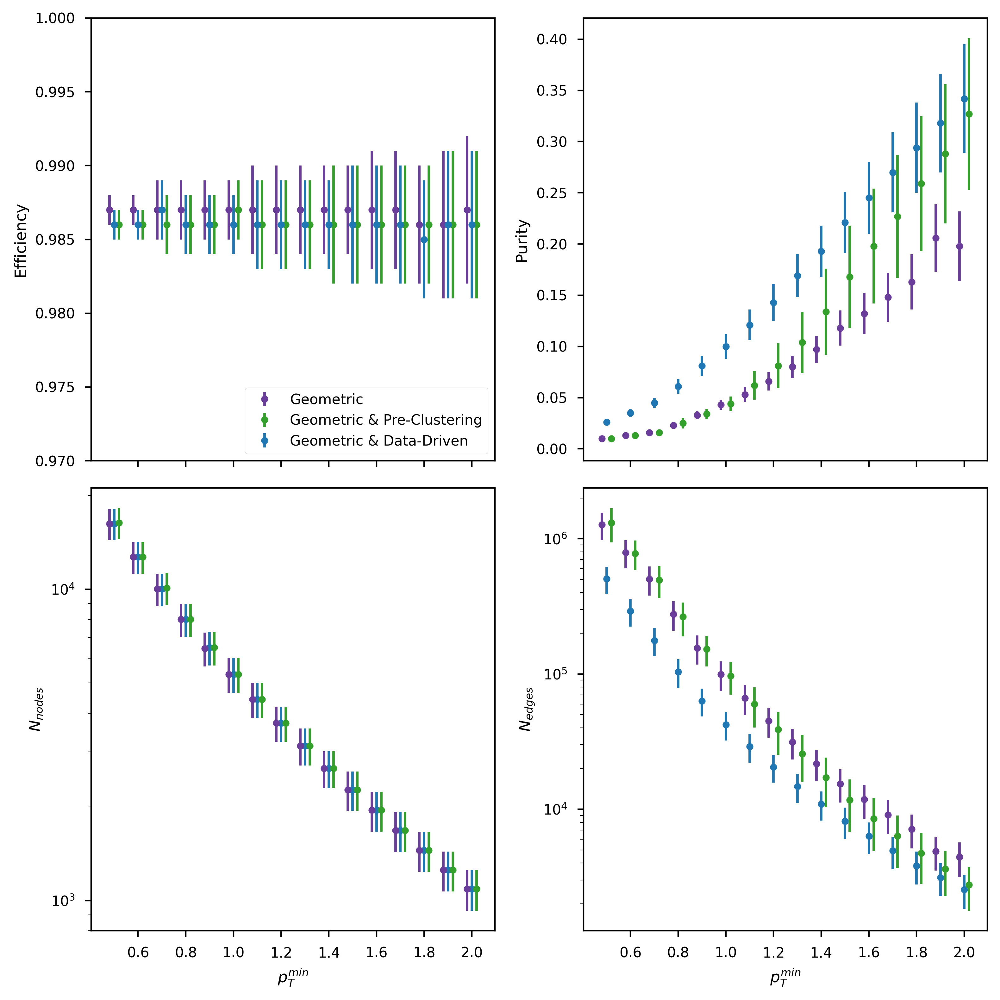

In [3]:
plt.style.use('seaborn-paper')
colors = cm.Paired.colors
ic = {'mm': 1, 'db': 3, 'hp': 9}
d = 0.02

fig, axs= plt.subplots(nrows=2,ncols=2,figsize=(8,8),dpi=400, sharex=True)
axs[0][0].errorbar(heptrkx_plus['pt']-d, 
                   heptrkx_plus['purity'], 
                   yerr=heptrkx_plus['purity_err'], 
                   label='Geometric', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['hp']])
axs[0][0].errorbar(dbscan['pt']+d, 
                   dbscan['purity'], 
                   yerr=dbscan['purity_err'], 
                   label='Geometric & Pre-Clustering', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['db']])
axs[0][0].errorbar(module_map['pt'], 
                   module_map['purity'], 
                   yerr=module_map['purity_err'], 
                   label='Geometric & Data-Driven', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['mm']])
axs[0,0].set_ylabel('Efficiency')
axs[0,0].set_ylim([0.97,1])

axs[0][1].errorbar(heptrkx_plus['pt']-d, 
                   heptrkx_plus['efficiency'], 
                   yerr=heptrkx_plus['efficiency_err'], 
                   label='Geometric', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['hp']])
axs[0][1].errorbar(dbscan['pt']+d, 
                   dbscan['efficiency'], 
                   yerr=dbscan['efficiency_err'], 
                   label='Geometric & Pre-Clustering', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['db']])
axs[0][1].errorbar(module_map['pt'], 
                   module_map['efficiency'], 
                   yerr=module_map['efficiency_err'], 
                   label='Geometric & Data-Driven', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['mm']])
axs[0,1].set_ylabel('Purity')

axs[1][0].errorbar(module_map['pt'], 
                   module_map['n_nodes'], 
                   yerr=module_map['n_nodes_err'], 
                   label='Module Map', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['mm']])
axs[1][0].errorbar(heptrkx_plus['pt']-d, 
                   heptrkx_plus['n_nodes'], 
                   yerr=heptrkx_plus['n_nodes_err'], 
                   label='HEP.TrkX+', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['hp']])
axs[1][0].errorbar(dbscan['pt']+d, 
                   dbscan['n_nodes'], 
                   yerr=dbscan['n_nodes_err'], 
                   label='DBSCAN', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3,color=colors[ic['db']])
axs[1,0].set_yscale('log')
axs[1,0].set_ylabel('$N_{nodes}$')
axs[1,0].set_xlabel('$p_T^{min}$')

axs[1][1].errorbar(module_map['pt'], 
                   module_map['n_edges'], 
                   yerr=module_map['n_edges_err'], 
                   label='Module Map', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['mm']])
axs[1][1].errorbar(heptrkx_plus['pt']-d, 
                   heptrkx_plus['n_edges'], 
                   yerr=heptrkx_plus['n_edges_err'], 
                   label='HEP.TrkX+', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['hp']])
axs[1][1].errorbar(dbscan['pt']+d, 
                   dbscan['n_edges'], 
                   yerr=dbscan['n_edges_err'], 
                   label='DBSCAN', ls='', marker='.', 
                   ms=8, alpha=1, capsize=3, color=colors[ic['db']])
axs[1,1].set_yscale('log')
axs[1,1].set_ylabel('$N_{edges}$')
axs[1,1].set_xlabel('$p_T^{min}$')



axs[0,0].legend(loc='lower right')
plt.tight_layout()
plt.savefig('paper_plots/graph_construction_measurements.pdf', format='PDF', bbox_inches='tight')
plt.show()

In [5]:
def plot_rz(X, idxs, y, save_fig=False, filename="rz.png"):
    X = np.array(X)
    feats_o = X[idxs[0,:]]
    feats_i = X[idxs[1,:]]
    
    fig = plt.figure(dpi=1000)
    for i in range(len(X)):        
        plt.scatter(X[i][2], X[i][0], c='silver', linewidths=0, marker='s', s=8)

    track_segs_o = feats_o[y>0.5]
    track_segs_i = feats_i[y>0.5]
    for i in range(len(track_segs_o)):
        plt.plot((track_segs_o[i][2], track_segs_i[i][2]),
                 (track_segs_o[i][0], track_segs_i[i][0]),
                  marker='o', ls='-', color='blue', lw=0.25, ms=0.1, alpha=1)

    false_edges_o = feats_o[y<0.5]
    false_edges_i = feats_i[y<0.5]
    for i in range(len(false_edges_o)):
        plt.plot((false_edges_o[i][2], false_edges_i[i][2]),
                 (false_edges_o[i][0], false_edges_i[i][0]),
                  marker='o', ls='-', color='black', lw=0.25, ms=0.1, alpha=0.5)
        
    plt.ylabel("r [m]")
    plt.xlabel("z [m]")
    if (save_fig): plt.savefig(filename, dpi=1200)
    plt.show()

In [43]:
def load_graph(graph_path):
    with np.load(graph_path) as f:
        x = torch.from_numpy(f['x'])
        edge_attr = torch.from_numpy(f['edge_attr'])
        edge_index = torch.from_numpy(f['edge_index'])
        y = torch.from_numpy(f['y'])
        pid = torch.from_numpy(f['pid'])
        data = Data(x=x, edge_index=edge_index,
                    edge_attr=torch.transpose(edge_attr, 0, 1),
                    y=y, pid=pid)
        data.num_nodes = len(x)
    return data


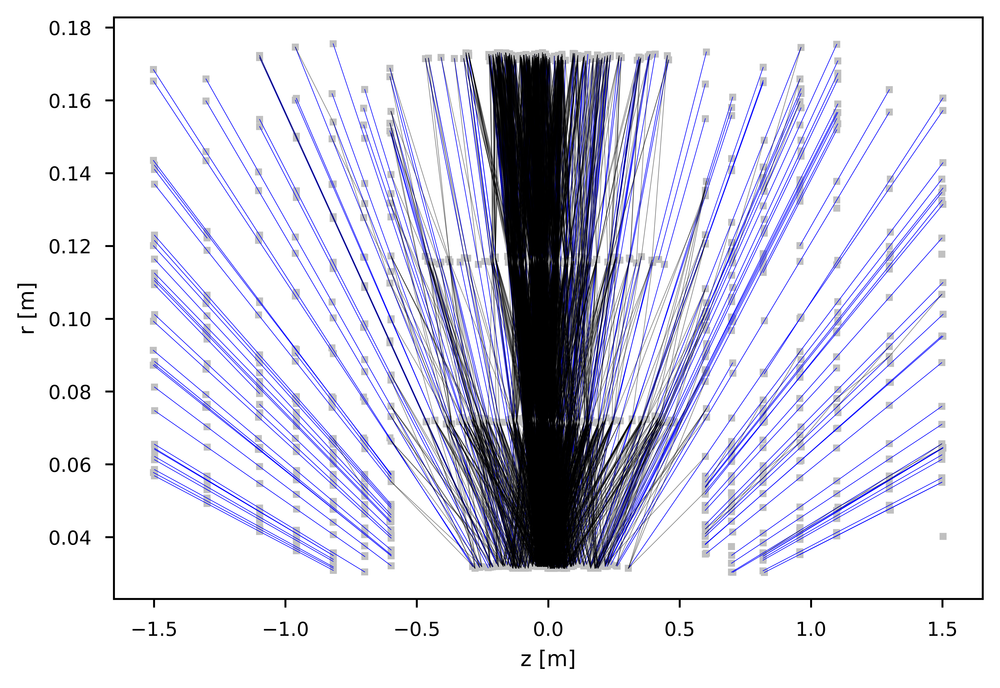

In [6]:
graph = load_graph('../../hitgraphs_1/heptrkx_plus_pyg_2/event000001975_g000.npz')
dbgraph = load_graph('../../hitgraphs_1/dbgraphs_2/event000001975_g000.npz')
mmgraph = load_graph('../../hitgraphs_1/module_map_2/event000001975_g000.npz')
plot_rz(graph.x, graph.edge_index, graph.y)

In [ ]:
plot_rz(dbgraph.x, dbgraph.edge_index, dbgraph.y)

In [ ]:
plot_rz(mmgraph.x, mmgraph.edge_index, mmgraph.y)

../../hitgraphs_1/heptrkx_plus_pyg_2
../../hitgraphs_1/dbgraphs_2
../../hitgraphs_1/module_map_2
../../hitgraphs_1/heptrkx_plus_pyg_1p5
../../hitgraphs_1/dbgraphs_1p5
../../hitgraphs_1/module_map_1p5
../../hitgraphs_1/heptrkx_plus_pyg_1
../../hitgraphs_1/dbgraphs_1
../../hitgraphs_1/module_map_1


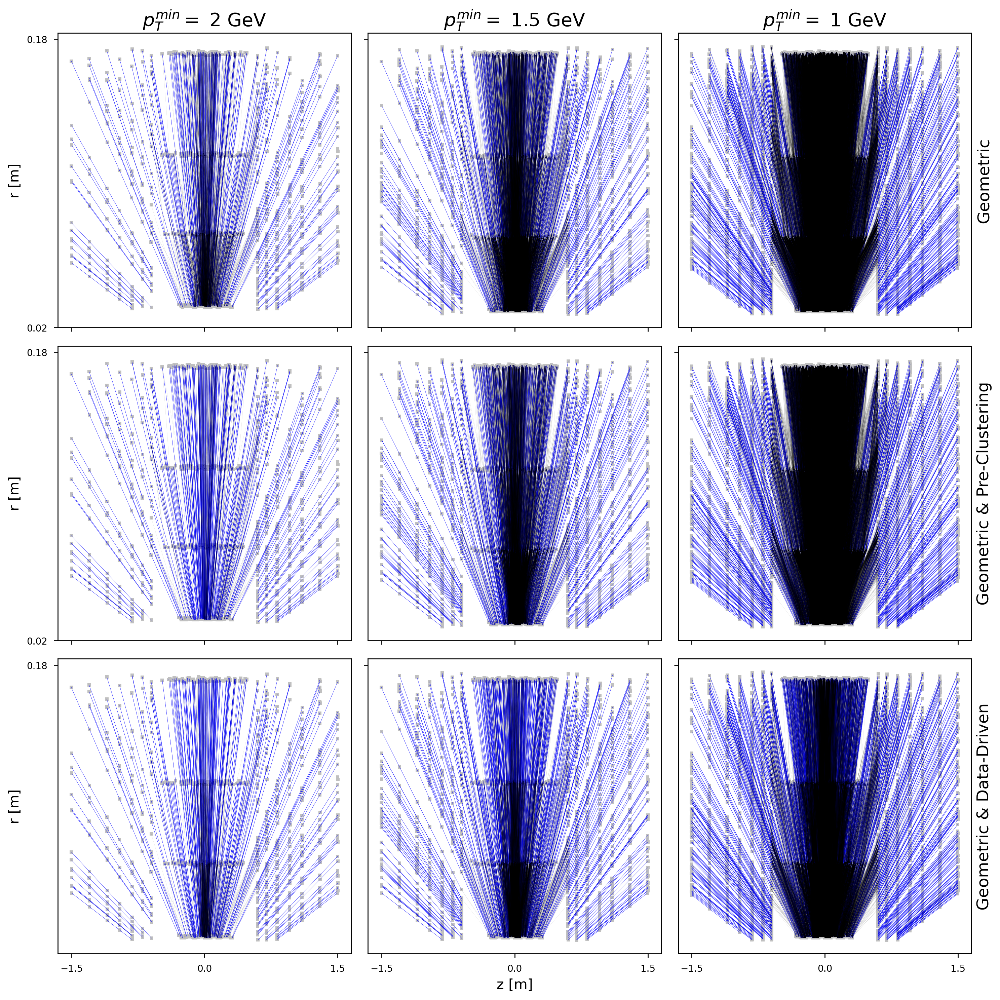

In [45]:
pt_cuts = ['2', '1p5', '1']
evtid = '1088'

fig, axs = plt.subplots(nrows=3, ncols=len(pt_cuts), figsize=(12,12), sharey=True, sharex=True, dpi=250)
for i, pt_cut in enumerate(pt_cuts):
    for j, construction in enumerate(['heptrkx_plus_pyg', 'dbgraphs', 'module_map']):
        graph_dir = '../../hitgraphs_1/{}_{}'.format(construction, pt_cut)
        print(graph_dir)
        evt_path = 'event00000'+evtid+'_g000.npz'
        graph = load_graph(os.path.join(graph_dir, evt_path))
    
        X, idxs, y = np.array(graph.x), graph.edge_index, graph.y
        feats_o = X[idxs[0,:]]
        feats_i = X[idxs[1,:]]
        track_segs_o = feats_o[y>0.5]
        track_segs_i = feats_i[y>0.5]
        
        axs[j][i].plot((track_segs_o[:,2], track_segs_i[:,2]),
                       (track_segs_o[:,0], track_segs_i[:,0]),
                        marker='o', ls='-', color='blue', lw=0.2, ms=0.1, alpha=1)
        
        false_edges_o = feats_o[y<0.5]
        false_edges_i = feats_i[y<0.5]
        axs[j][i].plot((false_edges_o[:,2], false_edges_i[:,2]),
                    (false_edges_o[:,0], false_edges_i[:,0]),
                    marker='o', ls='-', color='black', lw=0.1, ms=0.1, alpha=0.2)
    
        axs[j][i].scatter(X[:,2], X[:,0], c='silver', lw=0, marker='s', s=8)
        if pt_cut=='1p5': axs[0][i].set_title("$p_T^{min}=$" + " 1.5 GeV", fontsize=16)
        elif pt_cut=='0p5': axs[0][i].set_title("$p_T^{min}=$" + " 0.5 GeV", fontsize=16)
        else: axs[0][i].set_title("$p_T^{min}=$" + " {} GeV".format(pt_cut), fontsize=16)
        axs[1][i].set_xticks([-1.5, 0, 1.5])
    
axs[0][0].set_yticks([0.02, 0.18])
axs[1][0].set_yticks([0.02, 0.18])

axs[0][0].set_ylabel("r [m]", fontsize=12)
axs02_twin = axs[0][2].twinx()
axs02_twin.set_ylabel("Geometric", fontsize=14)
axs02_twin.set_yticklabels([])
axs02_twin.set_yticks([])
axs[1][0].set_ylabel("r [m]", fontsize=12)
axs12_twin = axs[1][2].twinx()
axs12_twin.set_ylabel("Geometric & Pre-Clustering", fontsize=14)
axs12_twin.set_yticklabels([])
axs12_twin.set_yticks([])
axs[2][0].set_ylabel("r [m]", fontsize=12)
axs12_twin = axs[2][2].twinx()
axs12_twin.set_ylabel("Geometric & Data-Driven", fontsize=14)
axs12_twin.set_yticklabels([])
axs12_twin.set_yticks([])
axs[2][1].set_xlabel("z [m]", fontsize=12)
plt.tight_layout()

#plt.savefig('graph_construction_staggered_pt.pdf', bbox_inches = 'tight')
plt.savefig('paper_plots/truth_labelled_graphs.pdf', format='PDF', bbox_inches='tight')
plt.show()

In [130]:
plt.style.use('seaborn-paper')
colors = cm.Paired.colors
base = '../train_output'

pt_map = {'0p5': 0.5, '0p6': 0.6, '0p7': 0.7, '0p8': 0.8, '0p9': 0.9, '1': 1,
          '1p1': 1.1, '1p2': 1.2, '1p3': 1.3, '1p4': 1.4, '1p5': 1.5, '1p6': 1.6,
          '1p7': 1.7, '1p8': 1.8, '1p9': 1.9, '2': 2}

train_output = os.listdir(base)
train_output = np.array([os.path.join(base, f) 
                         for f in train_output 
                         if ('.npy' in f and 
                             'hyper' not in f and
                             'hu' not in f and
                             'old' not in f and 
                             '20' not in f and 
                             '25' not in f)])
pt = np.array([pt_map[f.split('_')[-1].split('GeV')[0]] 
               for f in train_output])
train_output = train_output[np.argsort(-1*pt)]
pts = pt[np.argsort(-1*pt)]

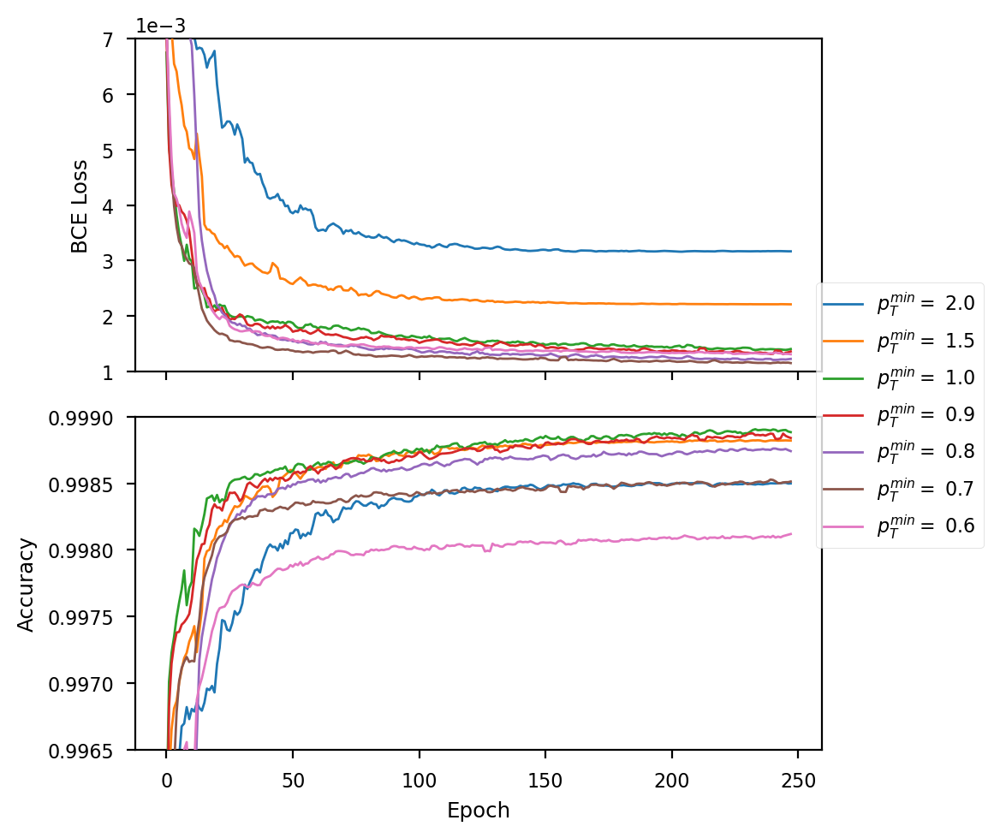

In [131]:
n_epoch = 250
colors = cm.Paired.colors

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(5,5), dpi=200, sharex=True)
for i,f in enumerate(train_output):
    out = np.load(f, allow_pickle=True).item()
    pt = pts[i]
    #if pt < 0.6 or pt > 1: continue
    epochs = np.arange(1, n_epoch+1, 1)
    m = len(out['test_loss']) if (len(out['test_loss']) < n_epoch) else n_epoch
    
    axs[0].plot(moving_average(out['test_loss'][:m], 3), markersize=5, 
                linewidth=1, zorder=i*5,
                linestyle='-', label=r'$p_T^{min}=$ '+str(pt))
    axs[1].plot(moving_average(out['test_acc'][:m], 3), markersize=5, 
                linewidth=1, zorder=i*5,
                linestyle='-', label=r'$p_T^{min}=$ '+str(pt))

    
handles, labels = axs[1].get_legend_handles_labels()
labels, handles = zip(*sorted(zip(labels, handles), reverse=True, key=lambda t: t[0].split(' ')[1]))
fig.legend(handles, labels, bbox_to_anchor=(1.17, 0.67))

#axs[0].legend(loc='best')
axs[0].set_ylim([0.001,0.007])
axs[0].set_ylabel('BCE Loss')
#axs[0].set_xlabel('Epoch')
axs[0].ticklabel_format(axis="y", style="sci", scilimits=(0,0))

axs[1].set_ylim([0.9965,0.999])
axs[1].set_ylabel('Accuracy')
axs[1].set_xlabel('Epoch')
axs[1].set_yticks([0.9965,0.997,0.9975,0.998,0.9985,0.999])


plt.savefig('paper_plots/training_convergence.pdf', format='PDF', bbox_inches='tight')
plt.tight_layout()
plt.show()

In [92]:
hyper_output = os.listdir(base)
hyper_output = np.array([os.path.join(base, f) 
                         for f in hyper_output 
                         if ('.npy' in f and 'hyper' in f)])

print(hyper_output)
hu = np.array([int(f.split('hyper')[-1].split('_')[0])
               for f in hyper_output])
pt = np.array([pt_map[f.split('_')[-1].split('GeV')[0]] 
               for f in hyper_output])

hyper_output = hyper_output[np.argsort(-1*hu)]
hus = hu[np.argsort(-1*hu)]
pts = pt[np.argsort(-1*hu)]
print(hyper_output)
print(pts)

['../train_output/hyper30_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper80_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper70_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper60_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper10_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper80_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper120_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper120_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper40_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper10_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper30_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper40_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper20_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper60_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper70_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hype

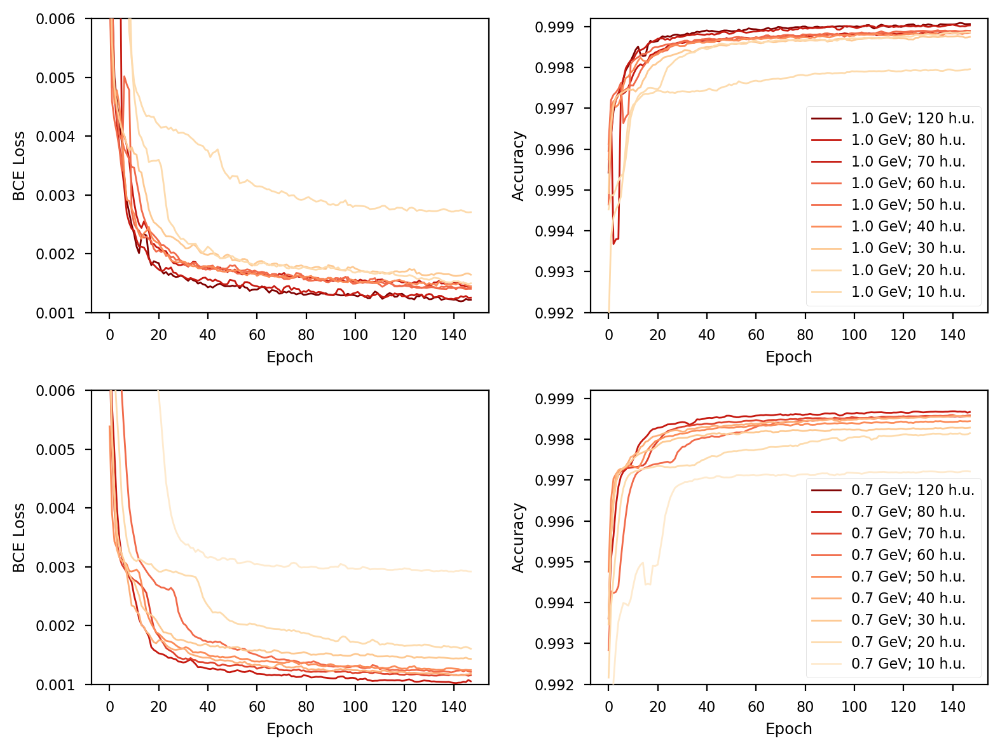

In [94]:
n_epoch = 150

#colors = cm.tab20c.colors
#c1 = cm.tab20c.colors
c1 = cm.BuGn
c0p7 = cm.OrRd
hu_map = {10: 0, 20: 1, 40: 2, 80: 3}
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(8,6), dpi=200)
for i, f in enumerate(hyper_output):
    out = np.load(f, allow_pickle=True).item()
    hu, pt = hus[i], pts[i]
    #if float(hu) > 100: continue
    if pt==1: 
        j=0
        #color = c1((pt+hu)/100)#colors[3-hu_map[hu]]
    else: 
        j=1
        color = c0p7((pt+hu)/100)#colors[11-hu_map[hu]]
        
    epochs = np.arange(1, n_epoch+1, 1)
    
    m = len(out['test_loss']) if (len(out['test_loss']) < n_epoch) else n_epoch
    axs[j,0].plot(moving_average(out['test_loss'][:m], 3), markersize=1, 
                  linewidth=1, zorder=i*5, linestyle='-', color=color,
                  label = str(pt) + ' GeV; ' + str(hu) +' h.u.')
    axs[j,1].plot(moving_average(out['test_acc'][:m], 3), markersize=1, 
                  linewidth=1, zorder=i*5, linestyle='-', color=color,
                  label = str(pt) + ' GeV; ' + str(hu) +' h.u.')

    handles, labels = axs[j,1].get_legend_handles_labels()
    labels, handles = zip(*sorted(zip(labels, handles), reverse=True, key=lambda t: t[0].split(' ')[0]))
    axs[j,1].legend(handles, labels)

#axs[0].legend(loc='best')
    axs[j,0].set_ylim([0.001,0.006])
    axs[j,0].set_ylabel('BCE Loss')
    axs[j,0].set_xlabel('Epoch')

    axs[j,1].set_ylim([0.992,0.9992])
    axs[j,1].set_ylabel('Accuracy')
    axs[j,1].set_xlabel('Epoch')
    

plt.tight_layout()
plt.show()

In [100]:
hyper_output = os.listdir(base)
hyper_output = np.array([os.path.join(base, f) 
                         for f in hyper_output 
                         if ('.npy' in f and 'hyper' in f)])

print(hyper_output)
hu = np.array([int(f.split('hyper')[-1].split('_')[0])
               for f in hyper_output])
pt = np.array([pt_map[f.split('_')[-1].split('GeV')[0]] 
               for f in hyper_output])

hyper_output = hyper_output[np.argsort(-1*hu)]
hus = hu[np.argsort(-1*hu)]
pts = pt[np.argsort(-1*hu)]
print(hyper_output)
print(hus)

['../train_output/hyper30_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper80_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper70_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper60_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper10_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper80_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper120_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper120_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper40_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper10_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper30_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper40_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper20_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hyper60_train1_PyG_heptrkx_plus_pyg_1GeV.npy'
 '../train_output/hyper70_train1_PyG_heptrkx_plus_pyg_0p7GeV.npy'
 '../train_output/hype

20


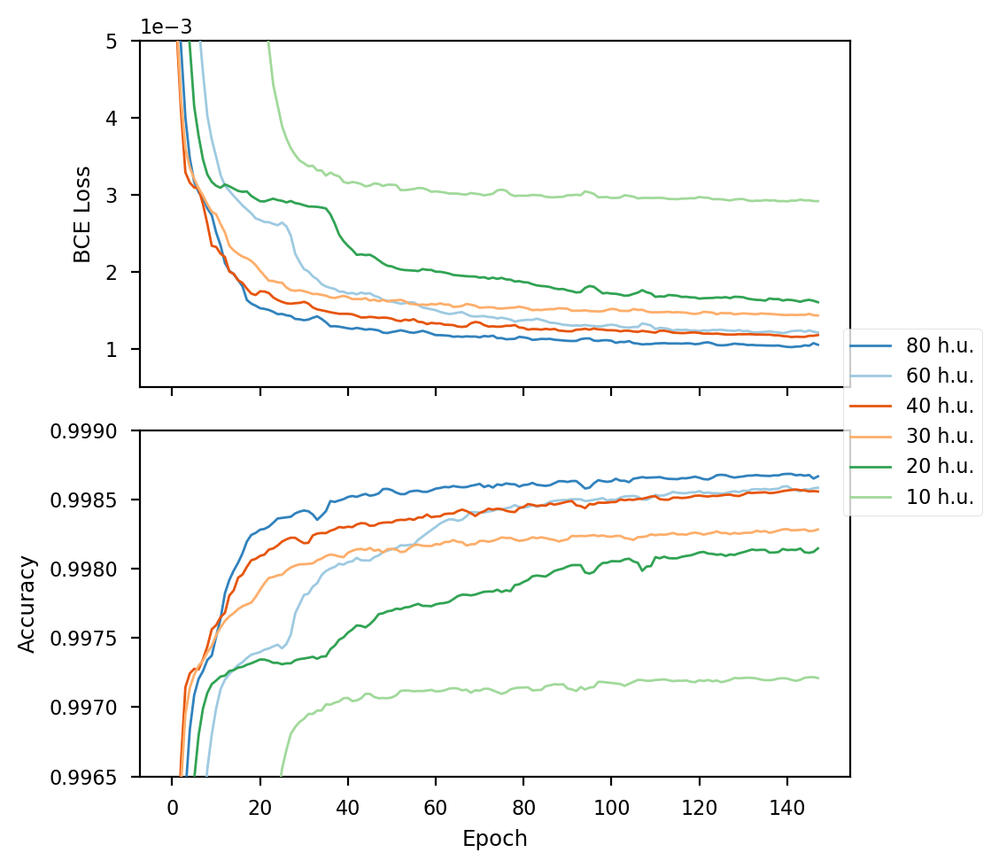

In [127]:
n_epoch = 150
colors = cm.tab20c.colors
print(len(colors))
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(5,5), dpi=200, sharex=True)
j=0
for i, f in enumerate(hyper_output):
    out = np.load(f, allow_pickle=True).item()
    hu, pt = hus[i], pts[i]
    if (pt!=0.7 or hu==50 or hu==70 or hu==120): continue
    
    epochs = np.arange(1, n_epoch+1, 1)
    
    m = len(out['test_loss']) if (len(out['test_loss']) < n_epoch) else n_epoch
    axs[0].plot(moving_average(out['test_loss'][:m], 3), markersize=1, 
                linewidth=1, zorder=i*5, linestyle='-', color=colors[2*j],
                label = str(hu) +' h.u.')
    axs[1].plot(moving_average(out['test_acc'][:m], 3), markersize=1, 
                linewidth=1, zorder=i*5, linestyle='-', color=colors[2*j],
                label = str(hu) +' h.u.')
    j+=1

handles, labels = axs[1].get_legend_handles_labels()
labels, handles = zip(*sorted(zip(labels, handles), reverse=True, key=lambda t: t[0].split(' ')[1]))
fig.legend(handles, labels, bbox_to_anchor=(1.13, 0.63))

axs[0].set_ylim([0.0005,0.005])
axs[0].set_ylabel('BCE Loss')
#axs[0].set_xlabel('Epoch')
axs[0].ticklabel_format(axis="y", style="sci", scilimits=(0,0))

axs[1].set_ylim([0.9965,0.999])
axs[1].set_ylabel('Accuracy')
axs[1].set_xlabel('Epoch')
    
plt.savefig('paper_plots/hyperparam_scans_0p7.pdf', format='PDF', bbox_inches='tight')
plt.tight_layout()
plt.show()

In [135]:
def draw_graph_rz(X, idxs, y, out,                   
                  cut=0.5, savefig=False, filename='out.png'):
    
    cutoff = int(len(idxs[1])/2.)
    X = np.array(X)
    feats_o = X[idxs[0,:cutoff]]
    feats_i = X[idxs[1,:cutoff]]
    
    directed_disagreements = np.where(((out[:cutoff]>cut) & 
                                       (out[cutoff:]<cut)) | 
                                      ((out[:cutoff]<cut) & 
                                       (out[cutoff:]>cut)) == True)[0]
    print('Directed Disagreements:', len(directed_disagreements))
    
    y, out = y[:cutoff], np.min(np.stack((out[:cutoff], out[cutoff:])), axis=0) #(out[:cutoff]+out[cutoff:])/2.
    
    print('X.shape', X.shape,
          'idxs.shape', idxs.shape,
          'y.shape', y.shape,
          'out.shape', out.shape)
    
    fig = plt.figure(dpi=200)
    ax = fig.add_subplot(111)
    ax.scatter(X[:,2], X[:,0], c='silver', lw=0, marker='s', s=8)
    
    TP = ((out>cut) & (y>0.5))
    print('Directed Disagreements (TP):', np.sum(TP[directed_disagreements]==True))
    TN = ((out<cut) & (y<0.5))
    print('Directed Disagreements (TN):', np.sum(TN[directed_disagreements]==True))
    FP = ((out>cut) & (y<0.5))
    FN = ((out<cut) & (y>0.5))
    wrong = (((out<cut) & (y>0.5)) | ((out>cut) & (y<0.5)))
    
    print('TP: {}'.format(np.sum(TP)))
    print('TN: {}'.format(np.sum(TN)))
    print('FP: {}'.format(np.sum(FP)))
    print('FN: {}'.format(np.sum(FN)))
    print('Wrong: {}/{}={:3f}'.format(np.sum(wrong), len(wrong), np.sum(wrong)/len(wrong)))
    print('Right: {}/{}={:3f}'.format(np.sum((TP|TN)), len(TP), np.sum((TP|TN))/len(TP)))
    print('TPR: {:.4f}'.format((np.sum(TP)/(np.sum(TP)+np.sum(FN)))))
    print('TNR: {:.4f}'.format(np.sum(TN)/(np.sum(TN)+np.sum(FP))))
    
    ax.plot((feats_o[TP][:,2], feats_i[TP][:,2]),
            (feats_o[TP][:,0], feats_i[TP][:,0]),
            'go-', lw=0.08, ms=0.0, alpha=0.3)
    ax.plot((feats_o[TN][:,2], feats_i[TN][:,2]),
            (feats_o[TN][:,0], feats_i[TN][:,0]),
            'ko-', lw=0.02, ms=0.0, alpha=0.1)
    ax.plot((feats_o[FP][:,2], feats_i[FP][:,2]),
            (feats_o[FP][:,0], feats_i[FP][:,0]),
            'ro-', lw=0.3, ms=0.0, alpha=0.3, zorder=10)
    ax.plot((feats_o[FN][:,2], feats_i[FN][:,2]),
            (feats_o[FN][:,0], feats_i[FN][:,0]),
            'yo-', lw=0.3, ms=0.0, alpha=0.3, zorder=10)

    green_patch = mpatches.Patch(color='green', label='True Positive')
    black_patch = mpatches.Patch(color='black', label='True Negative')
    red_patch = mpatches.Patch(color='red', label='False Positive')
    yellow_patch = mpatches.Patch(color='yellow', label='False Negative')
    ax.legend(handles=[green_patch, black_patch, red_patch, yellow_patch], loc='lower right')#bbox_to_anchor=[0.67, -0.2])
    ax.set_ylabel("r [m]")
    ax.set_xlabel("z [m]")
    ax.set_xlim([-1.6, 1.6])
    ax.set_xticks([-1.5, 1.5])
    ax.set_yticks([0.02, 0.2])
    ax.set_ylim([0, 0.2])
    if (savefig): plt.savefig(filename, format='PDF', bbox_inches='tight')
    plt.show()

torch.Size([4703, 3]) torch.Size([4, 190320]) torch.Size([2, 190320]) torch.Size([190320]) torch.Size([4703])
0.0015208928380161524
Directed Disagreements: 40
X.shape (4703, 3) idxs.shape (2, 190320) y.shape (95160,) out.shape (95160,)
Directed Disagreements (TP): 0
Directed Disagreements (TN): 37
TP: 3614
TN: 91448
FP: 91
FN: 7
Wrong: 98/95160=0.001030
Right: 95062/95160=0.998970
TPR: 0.9981
TNR: 0.9990


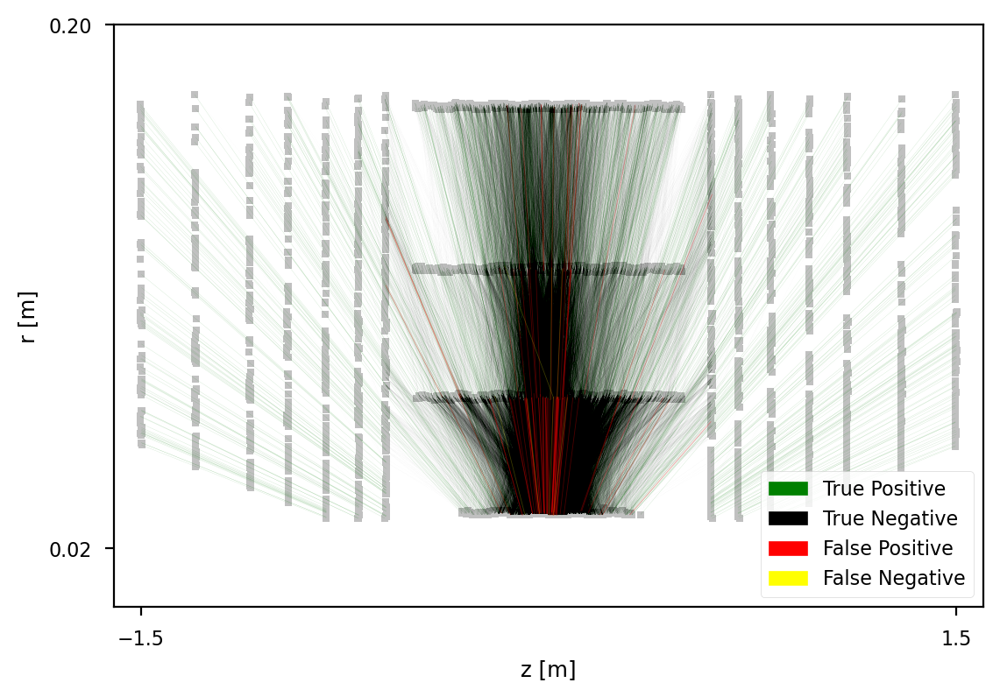

In [136]:
import torch.nn.functional as F

graph = load_graph('../../hitgraphs_1/heptrkx_plus_pyg_1/event000001220_g000.npz')

interaction_network = InteractionNetwork(40)
model='../trained_models/for_paper/train1_PyG_heptrkx_plus_pyg_epoch250_1GeV.pt'
interaction_network.load_state_dict(torch.load(model))
interaction_network.eval()

x, edge_attr, edge_index = graph.x, torch.transpose(graph.edge_attr, 0, 1), graph.edge_index
y, pid = graph.y, graph.pid
row, col = edge_index
row, col = torch.cat([row, col], dim=0), torch.cat([col, row], dim=0)
edge_index = torch.stack([row, col], dim=0)
edge_attr = torch.cat([edge_attr, -1*edge_attr], dim=1)
y = torch.cat([y,y])

print(x.shape, edge_attr.shape, edge_index.shape, y.shape, pid.shape)
data = Data(x=x, edge_index=edge_index,
            edge_attr=torch.transpose(edge_attr, 0, 1),
            y=y, pid=pid)
data.num_nodes = len(x)


output = interaction_network(data)
loss = F.binary_cross_entropy(output.detach().squeeze(1), data.y)

print(loss.item())
draw_graph_rz(x.detach().numpy(), edge_index.detach().numpy(), y.detach().numpy(), 
              output.detach().numpy().squeeze(1), cut=0.05049, savefig=True,
              filename='paper_plots/confusion_matrix_graph.pdf')

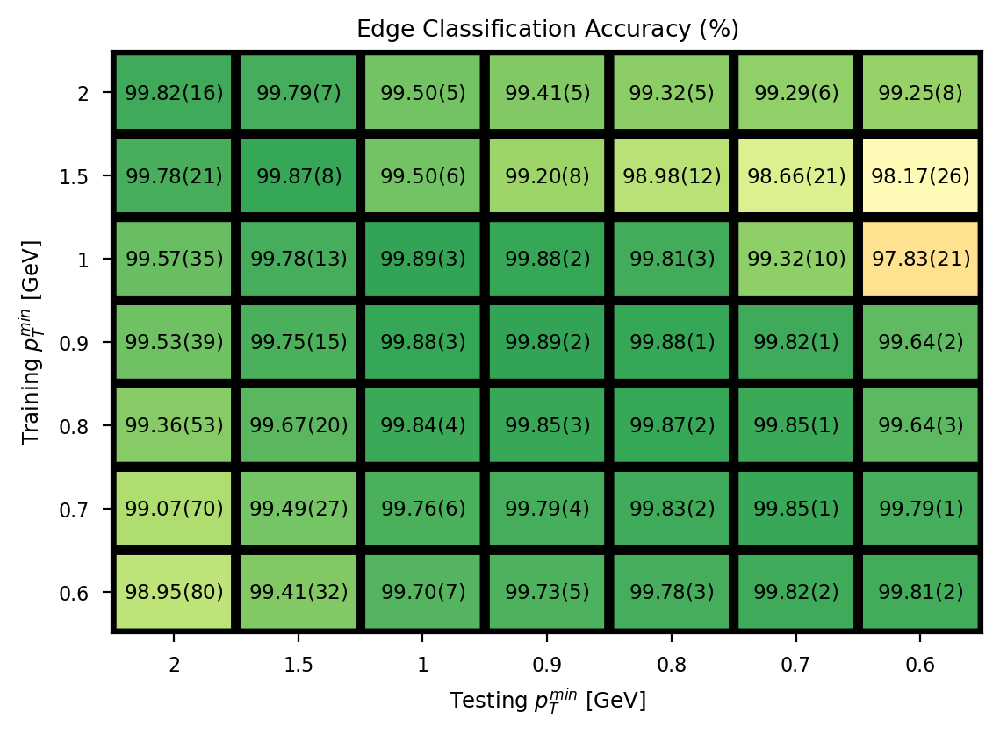

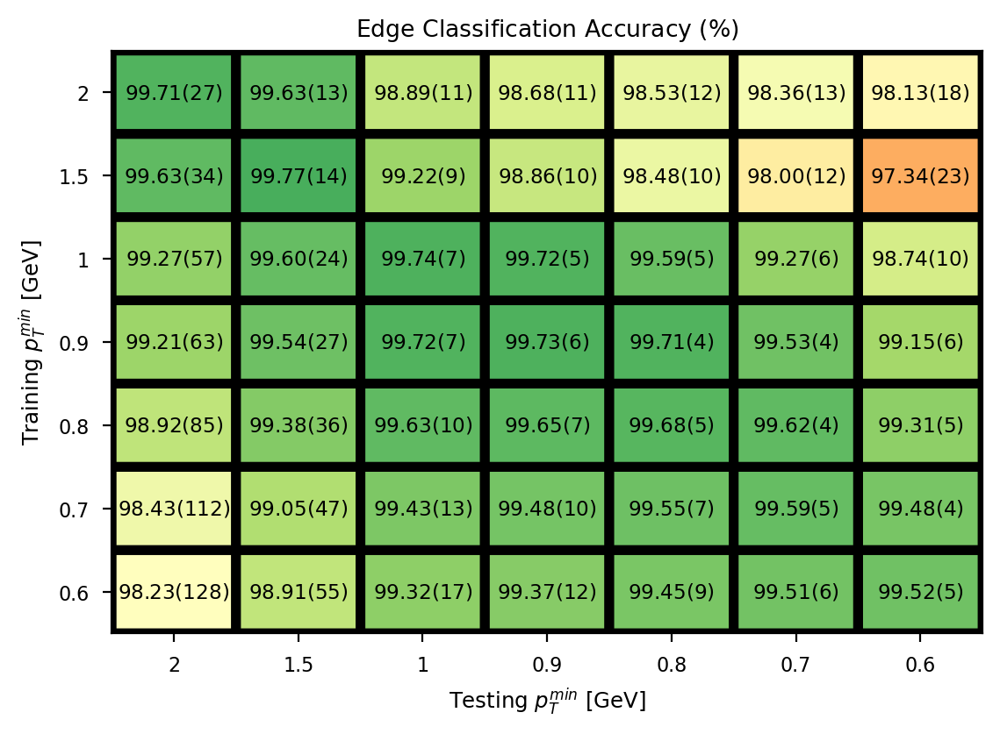

In [8]:
plt.style.use('seaborn-paper')
import matplotlib.colors as mcolors

for construction in ['heptrkx_plus_pyg', 'module_map']:
    out = np.load('../gnn_inference/accuracies/{}_accuracies.npy'
                  .format(construction), allow_pickle=True).item()

    losses = out['losses']
    accs = out['accs']
    acc_errs = out['acc_errs']
    accs = accs#[:-2, 2:]
    acc_errs = acc_errs#[:-2, 2:]

    accs_errs = []
    for i in range(accs.shape[0]): 
        line = []
        for j in range(accs.shape[1]):
            line.append('$000000000000000000000$')     
        accs_errs.append(line)
    accs_errs = np.array(accs_errs)

    for i in range(accs.shape[0]):
        for j in range(accs.shape[1]):
            #print(accs[i,j], acc_errs[i,j])
            accs_errs[i,j] = '${:.2f}({})$'.format(100*accs[i,j], int(acc_errs[i,j]*10**4))
            #print('-->', accs_errs[i,j])

    fig, ax = plt.subplots(dpi=200)
    heatmap = ax.pcolor(accs, edgecolors='k', cmap='RdYlGn', vmin=0.96, vmax=1.005, linewidths=4)

    for y in range(accs.shape[0]):
        for x in range(accs.shape[1]):
            ax.text(x + 0.5, y + 0.5, accs_errs[y, x],
                    horizontalalignment='center',
                    verticalalignment='center',
                    fontsize='smaller'
                   )
        
    ax.set_xticks([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5])
    ax.set_xticklabels([2, 1.5, 1, 0.9, 0.8, 0.7, 0.6])
    ax.set_yticks([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5])
    ax.set_yticklabels([0.6, 0.7, 0.8, 0.9, 1, 1.5, 2])
    ax.set_xlabel("Testing $p_T^{min}$ [GeV]")
    ax.set_ylabel("Training $p_T^{min}$ [GeV]")
    ax.set_title("Edge Classification Accuracy ($\%$)")#
    #plt.savefig('paper_plots/transfer_learning.pdf', format='PDF', bbox_inches='tight')
    plt.show()

['train3_0p6GeV.npy' 'train3_0p9GeV.npy' 'train3_0p9_UnionFind.npy']


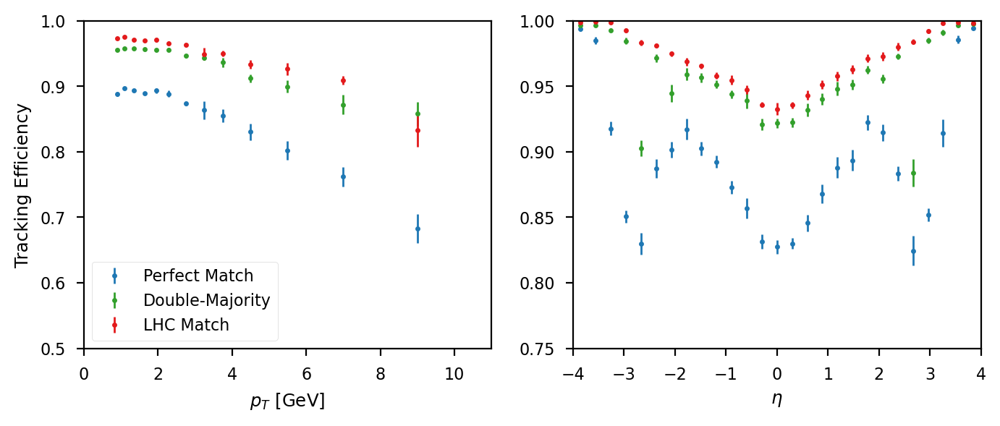

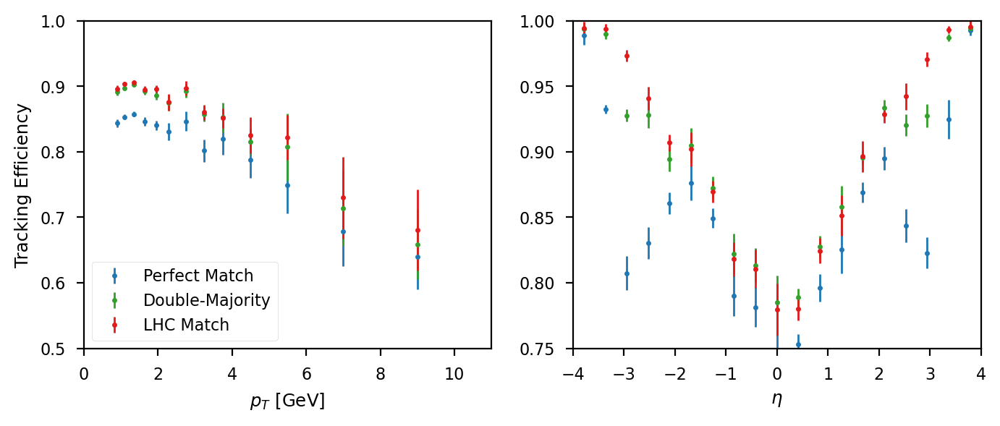

In [4]:
#output = {'bins': pt_bins,
#          'bin_centers': pt_bin_centers,
#          'effs_mean': mean_effs_by_pt,
#          'effs_std': std_effs_by_pt}

pt_map = {'0p5': 0.5, '0p6': 0.6, '0p7': 0.7, '0p8': 0.8, '0p9': 0.9, '1': 1,
          '1p1': 1.1, '1p2': 1.2, '1p3': 1.3, '1p4': 1.4, '1p5': 1.5, '1p6': 1.6,
          '1p7': 1.7, '1p8': 1.8, '1p9': 1.9, '2': 2}

plt.style.use('seaborn-paper')
colors = cm.Paired.colors
base = '../track_building/efficiencies'
effs_per_pt = np.array(os.listdir(base))
pts = np.array([f.split('_')[1].split('GeV')[0]
                for f in effs_per_pt])
pt_sort = pts.argsort()
pts, effs_per_pt = pts[pt_sort], effs_per_pt[pt_sort]
print(effs_per_pt)

for fname in effs_per_pt:
    pt = fname.split('_')[1].split('GeV')[0]
    if (pt != '0p9'): continue
    out = np.load(os.path.join(base,fname), 
                  allow_pickle=True).item()
    
    
    labels = {'exa': 'Double-Majority', 'tight': 'Perfect Match', 'cms': 'LHC Match'}
    fig, axs = plt.subplots(nrows=1, ncols=2, dpi=200, figsize=(8,3))
    for i, (var, var_info) in enumerate(out.items()):
        
        counter=1
        for j, (d, effs) in enumerate(var_info.items()):
            axs[i].errorbar(effs['bin_centers'], effs['effs_mean'], yerr=effs['effs_std'],
                            marker='.', linewidth=0, markersize=5, elinewidth=1, 
                            label=labels[d], color=colors[counter])
            counter+=2 
        
            if i==1: 
                axs[i].set_xlim([-4,4])
                axs[i].set_xlabel(r'$\eta$')
                if pt=='0p6': axs[i].set_ylim([0.3,1])
                if pt=='0p9': axs[i].set_ylim([0.75,1])
                
            if i==0: 
                axs[i].set_xlim([0,11])
                axs[i].set_xlabel(r'$p_T$ [GeV]')
                if pt=='0p6': axs[i].set_ylim([0.3,1])
                if pt=='0p9': axs[i].set_ylim([0.5,1])
                axs[i].set_ylabel("Tracking Efficiency")
                
            
    #fig.suptitle(r'DBSCAN Tracking $(p_T^{min}=$'+' {} GeV)'.format(pt_map[pt]))
    axs[0].legend(loc='lower left')
    plt.savefig('paper_plots/tracking_efficiencies.pdf', format='PDF', bbox_inches='tight')

    plt.show()
    
#for construction in ['heptrkx_plus_pyg', 'module_map']:
#    out = np.load('../gnn_inference/accuracies/{}_accuracies.npy'
#                  .format(construction), allow_pickle=True).item()
#
#    losses = out['losses']
#    accs = out['accs']

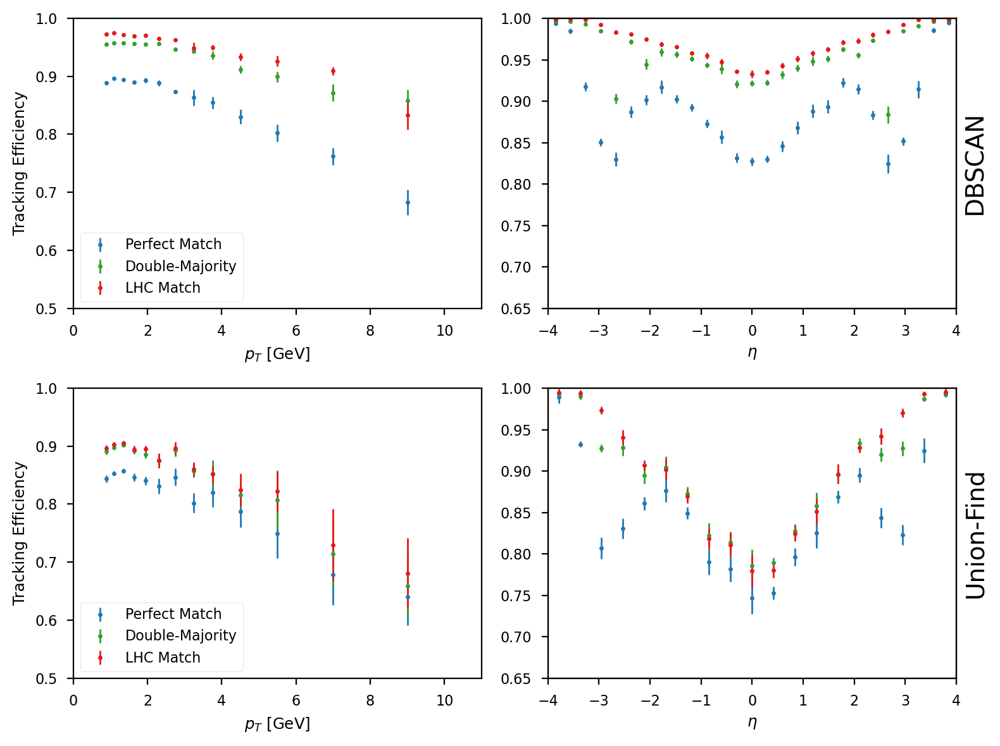

In [7]:
fig, axs = plt.subplots(nrows=2, ncols=2, dpi=200, figsize=(8,6))

files_0p9 = [f for f in effs_per_pt if '0p9' in f]
for f, fname in enumerate(files_0p9):
    pt = fname.split('_')[1].split('GeV')[0]
    out = np.load(os.path.join(base,fname), 
                  allow_pickle=True).item()
    
    labels = {'exa': 'Double-Majority', 'tight': 'Perfect Match', 'cms': 'LHC Match'}
    for i, (var, var_info) in enumerate(out.items()):
        counter=1
        for j, (d, effs) in enumerate(var_info.items()):
            axs[f,i].errorbar(effs['bin_centers'], effs['effs_mean'], yerr=effs['effs_std'],
                            marker='.', linewidth=0, markersize=5, elinewidth=1, 
                            label=labels[d], color=colors[counter])
            counter+=2 
        
            if i==1: 
                axs[f,i].set_xlim([-4,4])
                axs[f,i].set_xlabel(r'$\eta$')
                if pt=='0p6': axs[f,i].set_ylim([0.3,1])
                if pt=='0p9': axs[f,i].set_ylim([0.65,1])
                
            if i==0: 
                axs[f,i].set_xlim([0,11])
                axs[f,i].set_xlabel(r'$p_T$ [GeV]')
                if pt=='0p6': axs[f,i].set_ylim([0.3,1])
                if pt=='0p9': axs[f,i].set_ylim([0.5,1])
                axs[f,i].set_ylabel("Tracking Efficiency")
    
    axs_twin = axs[f][1].twinx()
    if 'UnionFind' in fname: 
        axs_twin.set_ylabel("Union-Find", fontsize=14)
    else:
        axs_twin.set_ylabel("DBSCAN", fontsize=14)
        
    axs_twin.set_yticklabels([])
    axs_twin.set_yticks([])
            
    #fig.suptitle(r'DBSCAN Tracking $(p_T^{min}=$'+' {} GeV)'.format(pt_map[pt]))
    axs[f,0].legend(loc='lower left')

plt.tight_layout()
plt.savefig('paper_plots/tracking_efficiencies.pdf', format='PDF', bbox_inches='tight')
plt.show()
    